# Import Dependencies

In [1]:
!pip install music21
#Importing Libraries
import tensorflow 
import numpy as np 
import pandas as pd 
from collections import Counter
import random
import IPython
from IPython.display import Image, Audio
import music21
from music21 import *
import matplotlib.pyplot as plt 
from sklearn.model_selection import train_test_split
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense, Dropout
import tensorflow.keras.backend as K
from tensorflow.keras.optimizers import Adamax
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
%matplotlib inline
import sys
import warnings
warnings.filterwarnings("ignore")
warnings.simplefilter("ignore")
np.random.seed(42)

  Obtaining dependency information for music21 from https://files.pythonhosted.org/packages/a1/1b/ef7bdf01df19cc7ac9294531a9c991c6d382bde6bc15c9d106b9a5e547ef/music21-9.1.0-py3-none-any.whl.metadata
  Obtaining dependency information for chardet from https://files.pythonhosted.org/packages/38/6f/f5fbc992a329ee4e0f288c1fe0e2ad9485ed064cac731ed2fe47dcc38cbf/chardet-5.2.0-py3-none-any.whl.metadata
  Obtaining dependency information for jsonpickle from https://files.pythonhosted.org/packages/d3/25/6e0a450430b7aa194b0f515f64820fc619314faa289458b7dfca4a026114/jsonpickle-3.0.2-py3-none-any.whl.metadata
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 22.8/22.8 MB 49.3 MB/s eta 0:00:00:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 199.4/199.4 kB 15.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 40.7/40.7 kB 4.2 MB/s eta 0:00:00


/opt/conda/lib/python3.10/site-packages/scipy/__init__.py:146: UserWarning: A NumPy version >=1.16.5 and <1.23.0 is required for this version of SciPy (detected version 1.24.3
  warnings.warn(f"A NumPy version >={np_minversion} and <{np_maxversion}"


# Loading Data

In [3]:
import os
from tqdm.notebook import tqdm
#Loading the list of chopin's midi files as stream 
filepath = "../input/classical-music-midi/chopin/"
#Getting midi files
all_midis= []
for i in tqdm(os.listdir(filepath)):
    if i.endswith(".mid"):
        tr = filepath+i
        midi = converter.parse(tr)
        all_midis.append(midi)
        

  0%|          | 0/48 [00:00<?, ?it/s]

## get the components out of these midi files

In [6]:
def extract_feature(file):
    notes = []
    pick = None
    for j in tqdm(file, desc='Processing Files', unit='file'):
        songs = instrument.partitionByInstrument(j)
        for part in songs.parts:
            pick = part.recurse()
            for element in pick:
                if isinstance(element, note.Note):
                    notes.append(str(element.pitch))
                elif isinstance(element, chord.Chord):
                    notes.append(".".join(str(n) for n in element.normalOrder))
                    
    return notes


# Getting the list of notes as corpus

In [7]:
Corpus = extract_feature(all_midis)
print('Total notes in all the Chopin midis in the dataset:', len(Corpus))

Processing Files:   0%|          | 0/48 [00:00<?, ?file/s]

Total notes in all the Chopin midis in the dataset: 57894


# Data Exploration

In [8]:
print(Corpus[:50])

['6.10.1', 'F#2', 'F3', 'G#3', 'F#3', 'B-3', 'C#3', '6.10.1', 'F#2', 'F3', 'G#3', 'F#3', 'B-3', 'C#3', '6.10.1', 'F#2', 'F3', 'G#3', 'F#3', 'B-3', 'C#3', 'F4', 'B4', 'C#2', 'G3', 'B-3', 'G#3', 'G#4', 'B3', 'C#3', '6.10.1', 'F#2', 'F3', 'G#3', 'F#3', 'B-3', 'C#3', 'C#4', '6.10', 'F#2', 'F3', 'G#3', 'F#3', '6.10', 'B-3', 'C#3', 'C#4', '6.10', 'F#2', 'F3']


**Printing Music Sheet**

In [37]:
#to play audio or corpus
print("Sample Audio From Data")
IPython.display.Audio("../input/music-generated-lstm/Corpus_Snippet.wav") 

Sample Audio From Data


# Examine all the notes in the  corpus

In [39]:
from collections import Counter

count_num = Counter(Corpus)

print("Total unique notes in the Corpus:", len(count_num))


Total unique notes in the Corpus: 397


In [40]:
# Exploring the notes dictionary
Notes = list(count_num.keys())
Recurrence = list(count_num.values())
# Average recurrent for a note in Corpus
def Average(lis):
    return sum(lis) / len(lis)
print('Average recurrence for a note in corpus:', Average(Recurrence))
print('Most frequent note in corpus appeared:', max(Recurrence), 'times')
print('Least frequent note in corpus appeared:', min(Recurrence), 'times')

Average recurrence for a note in corpus: 145.8287153652393
Most frequent note in corpus appeared: 1627 times
Least frequent note in corpus appeared: 1 times


# Ploting the distribution of notes

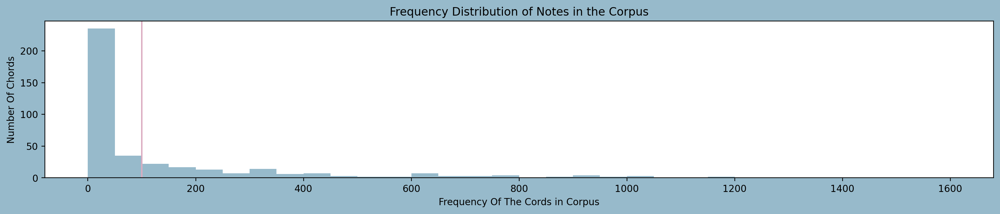

In [44]:
plt.figure(figsize=(18, 3), facecolor='#97BACB')
bins = np.arange(0,(max(Recurrence)), 50)
plt.hist(Recurrence, bins=bins, color='#97BACB')
plt.axvline(x=100, color='#DBACC1')
plt.title('Frequency Distribution of Notes in the Corpus')
plt.xlabel('Frequency Of The Cords in Corpus')
plt.ylabel('Number Of Chords')
plt.show()

In [45]:
# taking note which played less than 100 times
rare_note = []
for index, (key, value) in enumerate(count_num.items()):
    if value < 100 :
        m = key
        rare_note.append(m)
        
print('Total number of notes that occur less then 100 times:', len(rare_note))

Total number of notes that occur less then 100 times: 270


In [46]:
# Eleminating the rare note
for element in Corpus:
    if element in rare_note:
        Corpus.remove(element)
        
print('Length of corpus after elemination the rare notes', len(Corpus))

Length of corpus after elemination the rare notes 53752


# Data Preprocessing

In [52]:
symb=sorted(list(set(Corpus)))
L_corpus =len(Corpus) # length of corpus
L_symb = len(symb) # Length of total unique character
# Building dictonary to access the vocabulary from indices and vice versa
mapping = dict((c, i) for i,c in enumerate(symb))
reverse_mapping = dict((i, c) for i, c in enumerate(symb))

print("Total number of characters:", L_corpus)
print('Number of unique characters:', L_symb)

Total number of characters: 53752
Number of unique characters: 263


In [55]:
# Encoding and Spliting dataset
length = 40
features = []
targets = []
for i in range(0, L_corpus - length, 1):
    feature = Corpus[i:i + length]
    target = Corpus[i + length]
    features.append([mapping[j] for  j in feature])
    targets.append(mapping[target])
    
L_datapoints = len(targets)
print('Total number of sequences in the corpus:', L_datapoints)

Total number of sequences in the corpus: 53712


In [57]:
X = (np.reshape(features, (L_datapoints, length, 1))) / float(L_symb)
y = tensorflow.keras.utils.to_categorical(targets)

In [59]:
xtrain,xtest,ytrain,ytest = train_test_split(X,y,test_size=.2)

# Model Architecture

In [65]:
from tensorflow.keras.layers import Bidirectional
model = Sequential()
model.add(Bidirectional(LSTM(512, input_shape=(X.shape[1], X.shape[2]), return_sequences=True)))
model.add(Dropout(0.1))
model.add(Bidirectional(LSTM(256)))
model.add(Dense(256))
model.add(Dropout(0.1))
model.add(Dense(y.shape[1], activation='softmax'))

opt = Adamax(learning_rate=0.01)
model.compile(loss='categorical_crossentropy', optimizer=opt)
model.build(input_shape=(None, X.shape[1], X.shape[2]))

In [66]:
model.summary()

Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 bidirectional_4 (Bidirecti  (None, 40, 1024)          2105344   
 onal)                                                           
                                                                 
 dropout_4 (Dropout)         (None, 40, 1024)          0         
                                                                 
 bidirectional_5 (Bidirecti  (None, 512)               2623488   
 onal)                                                           
                                                                 
 dense_4 (Dense)             (None, 256)               131328    
                                                                 
 dropout_5 (Dropout)         (None, 256)               0         
                                                                 
 dense_5 (Dense)             (None, 263)              

In [67]:
history = model.fit(xtrain,ytrain,batch_size=256, epochs=200)

Epoch 1/200
168/168 [==============================] - 24s 94ms/step - loss: 4.7754
Epoch 2/200
168/168 [==============================] - 16s 96ms/step - loss: 4.4799
Epoch 3/200
168/168 [==============================] - 16s 97ms/step - loss: 4.4513
Epoch 4/200
168/168 [==============================] - 17s 98ms/step - loss: 4.4267
Epoch 5/200
168/168 [==============================] - 17s 100ms/step - loss: 4.4276
Epoch 6/200
168/168 [==============================] - 17s 101ms/step - loss: 4.4005
Epoch 7/200
168/168 [==============================] - 17s 101ms/step - loss: 4.3933
Epoch 8/200
168/168 [==============================] - 17s 101ms/step - loss: 4.3812
Epoch 9/200
168/168 [==============================] - 17s 102ms/step - loss: 4.3670
Epoch 10/200
168/168 [==============================] - 17s 102ms/step - loss: 4.3539
Epoch 11/200
168/168 [==============================] - 17s 103ms/step - loss: 4.3400
Epoch 12/200
168/168 [==============================] - 18s 104ms/s

# Function To Generate Music

In [69]:
def Malody_Generator(Note_Count):
    seed = xtest[np.random.randint(0,len(xtest)-1)]
    Music = ""
    Notes_Generated=[]
    for i in range(Note_Count):
        seed = seed.reshape(1,length,1)
        prediction = model.predict(seed, verbose=0)[0]
        prediction = np.log(prediction) / 1.0 #diversity
        exp_preds = np.exp(prediction)
        prediction = exp_preds / np.sum(exp_preds)
        index = np.argmax(prediction)
        index_N = index/ float(L_symb)   
        Notes_Generated.append(index)
        Music = [reverse_mapping[char] for char in Notes_Generated]
        seed = np.insert(seed[0],len(seed[0]),index_N)
        seed = seed[1:]
    #Now, we have music in form or a list of chords and notes and we want to be a midi file.
    Melody = chords_n_notes(Music)
    Melody_midi = stream.Stream(Melody)   
    return Music,Melody_midi


#getting the Notes and Melody created by the model
Music_notes, Melody = Malody_Generator(100)

**Sample Music**

In [72]:
Melody.write('midi', 'Melody_Generated.mid')
IPython.display.Audio('../input/music-generated-lstm/Melody_Generated 2.wav')